In [ ]:
%matplotlib inline
import os
import cv2.cv2
import cv2 as cv
import scipy.ndimage
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import SimpleITK as sitk
import math
# from IPython.display import Image
from PIL import Image
# import tensorflow as tf
import skimage
from ipywidgets import interactive, interact, widgets, Layout, Button, Box
from IPython.display import display
from skimage import exposure, transform
import pydicom
import seaborn as sns
from scipy import stats

import mglearn

from IPython.display import Image
import pydotplus

from sklearn.model_selection import KFold,cross_val_score,train_test_split,GridSearchCV,StratifiedKFold
from sklearn.preprocessing import normalize 
from sklearn.linear_model import LogisticRegression 
# from sklearn.linear_model import RandomizedLogisticRegression 
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix,roc_auc_score
from sklearn.metrics import mean_squared_error as mse
from sklearn.feature_selection import RFECV
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.pipeline import FeatureUnion
from sklearn.feature_selection import SelectKBest
from sklearn import datasets,tree,metrics
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import export_graphviz
from scipy import interp
# import graphviz 
import warnings
from sklearn.metrics import roc_curve, auc
warnings.filterwarnings("ignore")


os.environ["PATH"] += os.pathsep + 'C:\Program Files (x86)\Graphviz2.38\bin'



#使该文档能够使用中文
plt.rcParams['font.sans-serif']=['SimHei']
plt.rcParams['axes.unicode_minus']=False
sns.set(font='SimHei') 

In [2]:
path = os.path.abspath(r'F:\values')
subdirs = []
for dirName, subdirList, fileList in os.walk(path):
    for dir in subdirList:
        subdirs.append(os.path.join(dirName, dir))

print(len(subdirs))



162


In [3]:
lccniiList = []
rccniiList = []

lmloniiList = []
rmloniiList = []

dlmloniiList = []
drmloniiList = []

niiList = []
dcmList = []

lccdcmList = []
rccdcmList = []

lmlodcmList = []
rmlodcmList = []

dlmlodcmList = []
drmlodcmList = []


In [4]:
# 读取每一个nii
for i in range(len(subdirs)):
    for dirName, subdirList, fileList in os.walk((subdirs[i])):
        for filename in fileList:
            if '.nii' in filename.lower():
                niiList.append(os.path.join(dirName, filename))    
    
print(len(niiList))                    


# 读取每一个DCM
for i in range(len(subdirs)):
    for dirName, subdirList, fileList in os.walk((subdirs[i])):
        for filename in fileList:
            if 're.dcm'  in filename.lower():
                dcmList.append(os.path.join(dirName, filename)) 
            if 're1.dcm' in filename.lower():
                dcmList.append(os.path.join(dirName, filename)) 
            if 're2.dcm' in filename.lower():
                dcmList.append(os.path.join(dirName, filename)) 
            if 're3.dcm' in filename.lower():
                dcmList.append(os.path.join(dirName, filename))             
    
print(len(dcmList))                    

484
738


In [5]:
def get_information(List):
    patientID = []
    SeriesTime = []
    ViewPosition = []
    ImageLaterality = []
    CompressionForce = []
 
    for i in iter(List):
        information = {}
        ds = pydicom.dcmread(i)
        try:
            information['PatientID'] = ds.PatientID 
            information['StudyTime'] = ds.StudyTime
            information['BodyPartThickness'] = ds.BodyPartThickness
            information['SeriesTime'] = ds.SeriesTime
            information['ViewPosition'] = ds.ViewPosition
            information['ImageLaterality'] = ds.ImageLaterality
            information['CompressionForce'] = ds.CompressionForce

            patientID.append(information['PatientID'])
            SeriesTime.append(information['SeriesTime'])
            ViewPosition.append(information['ViewPosition'])
            ImageLaterality.append(information['ImageLaterality'])
            CompressionForce.append(information['CompressionForce'])

        except AttributeError:
            pass

    data_org = {'patientID': patientID,
        'SeriesTime': SeriesTime,
        'ViewPosition':ViewPosition,
        'ImageLaterality':ImageLaterality,
        'CompressionForce':CompressionForce}
    data = pd.DataFrame(data_org)
    
    return data


In [6]:
data = get_information(dcmList)
data.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce
0,X18108565,145635.000000,SIO,L,160.0
1,X18108565,145804.000000,ML,L,140.0
2,X18108565,150155.000000,MLO,L,130.0
3,X18108565,145921.000000,CC,R,140.0
4,X18108565,150038.000000,MLO,R,130.0


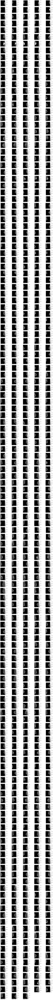

In [7]:
plt.figure(figsize=(20,400))
view_list= []
ary_list = []
view_scale_list = []
dcm_list = []

for i,k in enumerate(dcmList):
    plt.subplot(160,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    
    dcm = sitk.ReadImage(k)
    dcm_list.append(dcm)
    
    ary = sitk.GetArrayFromImage(dcm)[0,:,:]
    ary = cv.resize(ary, None, fx=0.2, fy=0.2)
#     ary = ary - ary.min()
    img = sitk.GetImageFromArray(ary)
    
    view = sitk.GetArrayViewFromImage(img)
    view = exposure.rescale_intensity(view, in_range=(1928, 2193))
    
#     view = view/256
    view_list.append(view)
    
    plt.imshow(view, cmap= 'gray')
    plt.xlabel(k[-15:])
    plt.colorbar()

In [8]:

    
# plt.figure(figsize=(20,400))

# dcm_scale_list = []
# # view_new_list = []


# it_dcm = iter(dcmList)

# for i,k in enumerate(it_dcm):
#     plt.subplot(140,5,i+1)
#     plt.xticks([])
#     plt.yticks([])
#     plt.grid(False)
    
#     dcm = sitk.ReadImage(k)
#     dcm_scale = sitk.IntensityWindowing(dcm, windowMinimum= 1928, windowMaximum= 2193, outputMinimum= 1928, outputMaximum= 2193)
#     dcm_scale_list.append(dcm_scale)
    
#     ary = sitk.GetArrayFromImage(dcm_scale)[0,:,:]
#     ary = cv.resize(ary, None, fx=0.5, fy=0.5)
    
#     img = sitk.GetImageFromArray(ary)
    
#     view = sitk.GetArrayViewFromImage(img)
# #     view_list.append(view)
    
#     plt.imshow(view, cmap= 'gray')
#     plt.xlabel(k[-15:])
#     plt.colorbar()

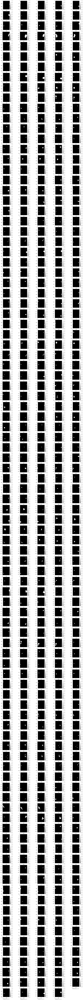

In [8]:
mask_list = []
nii_list = []
#
plt.figure(figsize=(20,400))
        
it_nii = iter(niiList)
    
for i,k in enumerate(it_nii):

    nii_itk = sitk.ReadImage(k)
    mask = sitk.GetArrayFromImage(nii_itk)[0,:,:]
#     mask = exposure.rescale_intensity(mask, in_range=(0, 256))
#     mask = mask * 65535
    mask = cv.resize(mask, None, fx=0.2, fy=0.2)
    mask_list.append(mask)
    nii_list.append(nii_itk)
    
    
    plt.subplot(160,5,i+1)
    plt.grid(False)
    plt.imshow(mask, cmap= 'gray')
    plt.xlabel(k[-15:])
    plt.colorbar()

In [9]:
# 获取文件名
def get_fileinformation(file_path):
    (filepath,tempfilename) = os.path.split(file_path);
    (filename,extension) = os.path.splitext(tempfilename);
    return filepath,tempfilename,filename,extension

In [10]:
niifilename = []
for i,file in enumerate(iter(niiList)):
    i+1
    file_path = file
    (filepath,tempfilename) = os.path.split(file_path);
    (filename,extension) = os.path.splitext(tempfilename);
    
    niifilename.append(filename)
#     print(i, filename)
    
# print(niifilename)
print(len(niifilename))

484


In [11]:
dcmList2 = []
dcmfilename = []

for i,file in enumerate(iter(dcmList)):
    i + 1

    file_path = file
    (filepath,tempfilename) = os.path.split(file_path);
    (filename,extension) = os.path.splitext(tempfilename);

    
    if filename.lower() in niifilename:
        dcmList2.append(file)
        dcmfilename.append(filename)
#         print(i,filename)
    else: 
        pass

# print(dcmList2)
print(len(dcmfilename))

484


In [12]:
for i,file in enumerate(iter(niiList)):
    i+1
    file_path = file
    (filepath,tempfilename) = os.path.split(file_path);
    (filename,extension) = os.path.splitext(tempfilename);
    if filename.lower() in dcmfilename:
        pass
    else:
        print(i, file)
    
# print(niifilename)
# print(len(niifilename))

In [13]:
view_list2= []
# dcmList2 = []
dcm_list2 = []

for i in range(len(dcmList)):
#      i + 1

    file_path = dcmList[i]
    (filepath,tempfilename) = os.path.split(file_path);
    (filename,extension) = os.path.splitext(tempfilename);

    
    if filename.lower() in niifilename:
#         dcmList2.append(filepath)
        view_list2.append(view_list[i])
        dcm_list2.append(dcm_list[i])
    else:
        pass

# print(len(dcm_list2))
print(len(dcmList2))
print(len(view_list2))

484
484


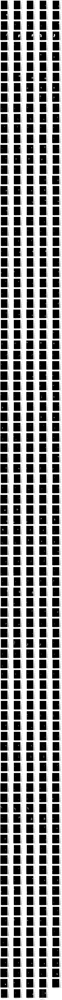

In [14]:
lesions = []
plt.figure(figsize=(20,400))

for i in range(len(niiList)):
    lesion = cv2.bitwise_and(view_list2[i].astype('uint16'),mask_list[i])
    lesions.append(lesion)
    
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.subplot(120,5,i+1)
    plt.imshow(lesion, cmap= 'gray')
    plt.xlabel(niiList[i][-15:])
    plt.colorbar()

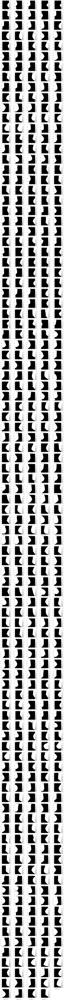

In [15]:

plt.figure(figsize=(20,400))

breast_binary = []

for i in range(len(niiList)):
    global_threshold = 2000
    view_blurred = cv2.GaussianBlur(view_list2[i], (3,3), 0)
    _, view_binary = cv.threshold(view_blurred, global_threshold,
                             maxval= 1, type=cv.THRESH_BINARY)

    breast_binary.append(view_binary)
    
    plt.subplot(120,5,i+1)
    plt.grid(False)
    plt.imshow(view_binary, cmap= 'gray')
    plt.xlabel(niiList[i][-15:])
    plt.colorbar()
    



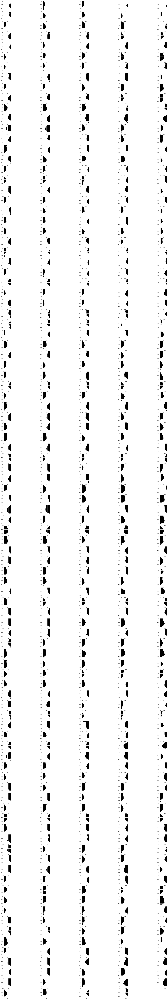

In [16]:

plt.figure(figsize=(30,200))

bg_list = []

for i in range(len(niiList)):
    global_threshold = 2000
    view_blurred = cv2.GaussianBlur(view_list2[i], (3,3), 0)
    _, bg_binary = cv.threshold(view_blurred, global_threshold,
                             maxval= 1, type=cv.THRESH_BINARY_INV)
    bg_list.append(bg_binary)
    
    plt.subplot(120,5,i+1)
    plt.imshow(bg_binary, cmap= 'gray')
#     plt.xlabel(niiList[i][-15:])
#     plt.colorbar()

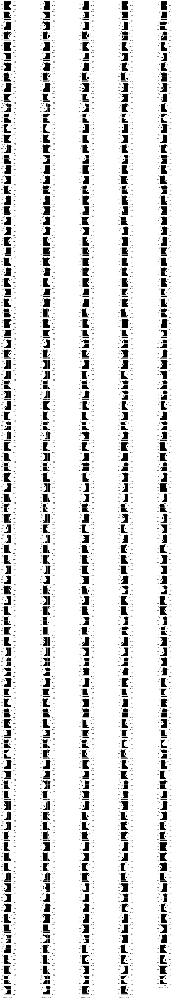

In [17]:
plt.figure(figsize=(30,200))
breast_mask_list = []
breasts = []
for i in range(len(niiList)):
    breast_mask = cv2.bitwise_and((1 - (mask_list[i])), breast_binary[i].astype('uint16'))
#     breast = cv2.bitwise_and(view_list2[i].astype('uint8'), breast_mask.astype('uint8'))
#     breasts.append(breast)
    breast_mask_list.append(breast_mask)
    
    plt.subplot(120,5,i+1)
    plt.imshow(breast_mask, cmap= 'gray')
    plt.xlabel(niiList[i][-15:])
    plt.colorbar()

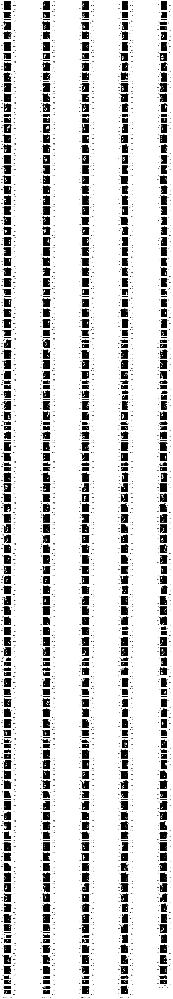

In [26]:
plt.figure(figsize=(30,200))

bpe_masks = []

for i in range(len(niiList)):
    global_threshold =22500
# mlo_blurred_col = cv.cvtColor(mlo_blurred, cv2.COLOR_GRAY2BGR)
# mlo_blurred_u8 = cv.convertScaleAbs(mlo_blurred, alpha= u16u8_alpha)

    view_blurred = cv2.GaussianBlur(view_list2[i], (3,3), 0)
    _, background = cv.threshold(view_blurred, global_threshold,
                             maxval= 1, type=cv.THRESH_BINARY)
    
    breast_mask = cv2.bitwise_and((1 - (mask_list[i])), breast_binary[i].astype('uint16'))
    
    bpe_mask = cv2.bitwise_and(background.astype('uint16'), breast_mask)
    bpe_masks.append(bpe_mask)
    
    plt.subplot(120,5,i+1)
    plt.imshow(bpe_mask, cmap= 'gray')
    plt.xlabel(niiList[i][-15:])
    plt.colorbar()

In [20]:

# plt.figure(figsize=(20,400))

# for i in range(len(niiList)):
#     lesion = cv2.bitwise_and(view_list2[i].astype('uint16'),breast_mask_list[i])
#     lesions.append(lesion)
    
#     plt.xticks([])
#     plt.yticks([])
#     plt.grid(False)
#     plt.subplot(120,5,i+1)
#     plt.imshow(lesion, cmap= 'gray')
#     plt.xlabel(niiList[i][-15:])
#     plt.colorbar()

In [27]:
mean_vals_bg = []
for i in range(len(niiList)):
    mean_val = cv2.mean(view_list2[i], bg_list[i].astype('uint8'))
    mean_vals_bg.append(mean_val[0])
    print( 'mean values of background: {}'.format(mean_val[0]))

mean values of background: 0.023404924123356825
mean values of background: 0.27428891982298315
mean values of background: 0.02757740264247292
mean values of background: 0.12122376394133662
mean values of background: 0.11936067025802612
mean values of background: 0.16137891506561428
mean values of background: 0.027512425099112316
mean values of background: 0.46014624418347
mean values of background: 0.014632215291497407
mean values of background: 0.0
mean values of background: 0.0009931564683838489
mean values of background: 0.0
mean values of background: 0.5218043729760343
mean values of background: 0.3443563704510345
mean values of background: 0.4352982604408761
mean values of background: 0.49737656595431096
mean values of background: 3.467487751081777
mean values of background: 2.5305675634643503
mean values of background: 0.05187736884210343
mean values of background: 0.7819692371259783
mean values of background: 0.036096193233469756
mean values of background: 0.017325489493745305
m

In [28]:
mean_vals_lesion = []
for i in range(len(niiList)):
    mean_val = cv2.mean(view_list2[i], mask=mask_list[i].astype('uint8'))
#     mean_val = mean_val[0] - mean_vals_bg[i]
    mean_vals_lesion.append(mean_val[0])
    print( 'mean values of lesion: {}'.format(mean_val))

mean values of lesion: (33250.50063211125, 0.0, 0.0, 0.0)
mean values of lesion: (26734.11079943899, 0.0, 0.0, 0.0)
mean values of lesion: (30806.959957850366, 0.0, 0.0, 0.0)
mean values of lesion: (31670.258535071385, 0.0, 0.0, 0.0)
mean values of lesion: (27483.83263009845, 0.0, 0.0, 0.0)
mean values of lesion: (58009.522168674695, 0.0, 0.0, 0.0)
mean values of lesion: (30599.133663366338, 0.0, 0.0, 0.0)
mean values of lesion: (30991.9698630137, 0.0, 0.0, 0.0)
mean values of lesion: (21576.964912280702, 0.0, 0.0, 0.0)
mean values of lesion: (19651.227941176472, 0.0, 0.0, 0.0)
mean values of lesion: (21483.96325878594, 0.0, 0.0, 0.0)
mean values of lesion: (44594.4556141062, 0.0, 0.0, 0.0)
mean values of lesion: (42687.03304347826, 0.0, 0.0, 0.0)
mean values of lesion: (37380.834353619015, 0.0, 0.0, 0.0)
mean values of lesion: (41403.91662806855, 0.0, 0.0, 0.0)
mean values of lesion: (46121.87278248362, 0.0, 0.0, 0.0)
mean values of lesion: (55365.60474802166, 0.0, 0.0, 0.0)
mean valu

In [29]:
mean_vals_breast = []
for i in range(len(niiList)):
    mean_val = cv2.mean(view_list2[i], breast_mask_list[i].astype('uint8'))
    mean_val = mean_val[0] - mean_vals_bg[i]
    mean_vals_breast.append(mean_val)
    print( 'mean values of breast: {}'.format(mean_val))

mean values of breast: 20855.26137077351
mean values of breast: 20341.84830667693
mean values of breast: 21637.976450272672
mean values of breast: 21302.575434488255
mean values of breast: 23073.744349749806
mean values of breast: 21667.018494325628
mean values of breast: 21875.1989698838
mean values of breast: 21658.580981415715
mean values of breast: 22536.74549324496
mean values of breast: 21621.35814190441
mean values of breast: 21553.69512204472
mean values of breast: 21006.68847119495
mean values of breast: 20722.97454625187
mean values of breast: 20552.19673642459
mean values of breast: 20883.63608065766
mean values of breast: 21317.58155369409
mean values of breast: 19945.268669976886
mean values of breast: 19469.072282851706
mean values of breast: 24300.737236748646
mean values of breast: 22949.949472709108
mean values of breast: 22490.892661216327
mean values of breast: 21250.73476548209
mean values of breast: 19540.215338610662
mean values of breast: 19529.36642414517
mean v

In [30]:
bpes = []
for i in range(len(niiList)):
    bpe = cv2.mean(view_list2[i], bpe_masks[i].astype('uint8'))
    bpes.append(bpe[0])
    print('bpe :', bpe[0])

bpe : 29939.523641387783
bpe : 26741.588936931566
bpe : 28009.94879190248
bpe : 31798.83224291226
bpe : 35128.01192842943
bpe : 35531.943942851474
bpe : 28097.11717673008
bpe : 28531.718609821743
bpe : 29900.258956214067
bpe : 28563.434859514255
bpe : 28106.723933487803
bpe : 26771.010922599246
bpe : 27738.87391955745
bpe : 28032.633759689925
bpe : 29845.528345802162
bpe : 31292.302507724366
bpe : 31918.974399047405
bpe : 33573.95298546665
bpe : 32351.399634873986
bpe : 33492.90038355379
bpe : 33323.49196141479
bpe : 28570.824466544367
bpe : 27776.179576719576
bpe : 28488.396786056925
bpe : 27706.935115039283
bpe : 27821.332218159187
bpe : 27627.825484166802
bpe : 27749.079456193354
bpe : 28792.496953815917
bpe : 30799.17050890128
bpe : 28035.37006400788
bpe : 30052.662598022504
bpe : 26303.961075949366
bpe : 27555.619778400407
bpe : 27942.88179762022
bpe : 30034.627927311438
bpe : 28704.736643026004
bpe : 26925.171095268957
bpe : 26504.237522807773
bpe : 29123.141343761108
bpe : 28977

In [31]:
vals_diff = []
for i in range(len(niiList)):
    val_diff = mean_vals_lesion[i] - mean_vals_breast[i]
    vals_diff.append(val_diff)
    print("value difference: {}".format(val_diff))

value difference: 12395.239261337741
value difference: 6392.26249276206
value difference: 9168.983507577694
value difference: 10367.68310058313
value difference: 4410.088280348646
value difference: 36342.503674349064
value difference: 8723.934693482537
value difference: 9333.388881597984
value difference: -959.7805809642559
value difference: -1970.1302007279373
value difference: -69.7318632587776
value difference: 23587.76714291125
value difference: 21964.05849722639
value difference: 16828.637617194425
value difference: 20520.280547410894
value difference: 24804.291228789527
value difference: 35420.33607804477
value difference: 33180.85785493211
value difference: 37683.55142097285
value difference: 38486.5234039183
value difference: 11822.478767355104
value difference: 13654.663362667656
value difference: 10747.217782408447
value difference: 7964.779593553943
value difference: 7710.489752597183
value difference: 943.505393638734
value difference: 3331.4523709050263
value difference: 3

In [32]:
data2 = get_information(dcmList2)
data2

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce
0,X18108565,145635.000000,SIO,L,160.0
1,X18108565,145804.000000,ML,L,140.0
2,X18108565,150155.000000,MLO,L,130.0
3,X18113130,110552.000000,CC,R,100.0
4,X18113130,111130.000000,CC,R,80.0
...,...,...,...,...,...
479,FS001681716003,101844.000000,MLO,R,160.0
480,FS001672678003,095946.000000,CC,L,180.0
481,FS001672678003,100120.000000,MLO,L,180.0
482,FS001611659004,102029.000000,CC,R,140.0


In [33]:
data_val = {'breast_background': mean_vals_breast,
        'lesion_val': mean_vals_lesion,
        'image_background':mean_vals_bg,
        'value difference':vals_diff,
        'bpe': bpes}
data_val = pd.DataFrame(data_val)
data_val

,breast_background,lesion_val,image_background,value difference,bpe
0,20855.261371,33250.500632,0.023405,12395.239261,29939.523641
1,20341.848307,26734.110799,0.274289,6392.262493,26741.588937
2,21637.976450,30806.959958,0.027577,9168.983508,28009.948792
3,21302.575434,31670.258535,0.121224,10367.683101,31798.832243
4,23073.744350,27483.832630,0.119361,4410.088280,35128.011928
...,...,...,...,...,...
479,19715.451505,26991.684211,0.970412,7276.232705,26762.296892
480,20246.379515,23843.053128,0.051667,3596.673613,26981.863370
481,20721.767003,25252.821700,0.000000,4531.054696,26269.646798
482,19821.185281,24413.724087,0.109432,4592.538806,29416.871396


In [34]:
data_lesion = pd.concat([data2, data_val], axis = 1)
data_lesion['SeriesTime'] = data_lesion['SeriesTime'].astype('float')
time_2 = []
for i in range(len(data_lesion['SeriesTime'])):
    time_2.append(pd.to_datetime(( '%06d' % (data_lesion['SeriesTime'][i])), format='%H%M%S'))

time_2 = pd.DataFrame(time_2, columns = ['time'])

data_final = pd.concat([data_lesion, time_2], axis=1, sort=False)

In [35]:
data_final['rank'] = data_final.groupby(['patientID','ImageLaterality'])['time'].rank(ascending = True)

data_final

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,time,rank
0,X18108565,145635.0,SIO,L,160.0,20855.261371,33250.500632,0.023405,12395.239261,29939.523641,1900-01-01 14:56:35,1.0
1,X18108565,145804.0,ML,L,140.0,20341.848307,26734.110799,0.274289,6392.262493,26741.588937,1900-01-01 14:58:04,2.0
2,X18108565,150155.0,MLO,L,130.0,21637.976450,30806.959958,0.027577,9168.983508,28009.948792,1900-01-01 15:01:55,3.0
3,X18113130,110552.0,CC,R,100.0,21302.575434,31670.258535,0.121224,10367.683101,31798.832243,1900-01-01 11:05:52,1.0
4,X18113130,111130.0,CC,R,80.0,23073.744350,27483.832630,0.119361,4410.088280,35128.011928,1900-01-01 11:11:30,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...
479,FS001681716003,101844.0,MLO,R,160.0,19715.451505,26991.684211,0.970412,7276.232705,26762.296892,1900-01-01 10:18:44,2.0
480,FS001672678003,95946.0,CC,L,180.0,20246.379515,23843.053128,0.051667,3596.673613,26981.863370,1900-01-01 09:59:46,1.0
481,FS001672678003,100120.0,MLO,L,180.0,20721.767003,25252.821700,0.000000,4531.054696,26269.646798,1900-01-01 10:01:20,2.0
482,FS001611659004,102029.0,CC,R,140.0,19821.185281,24413.724087,0.109432,4592.538806,29416.871396,1900-01-01 10:20:29,1.0


In [36]:
# 单独提取出第一张片子
data_1 = data_final[data_final['rank'] == 1]
data_2 = data_final[data_final['rank'] == 2]
data_3 = data_final[data_final['rank'] == 3]
data_4 = data_final[data_final['rank'] == 4]
data_5 = data_final[data_final['rank'] == 5]
data_6 = data_final[data_final['rank'] == 6]

print(data_1.shape)
print(data_2.shape)
print(data_3.shape)
print(data_4.shape)
print(data_5.shape)
print(data_6.shape)

(170, 12)
(170, 12)
(138, 12)
(6, 12)
(0, 12)
(0, 12)


In [37]:
data_final['rank'] = data_final['rank'].astype('float')

In [38]:
data_1 = data_1.rename(columns = {'SeriesTime':'SeriesTime_1',
                                  'ViewPosition':'ViewPosition_1',
#                                   'ImageLaterality':'ImageLaterality_1',
                                  'CompressionForce':'CompressionForce_ 1',
                                  'rank':'rank_1',
                                  'time':'time_1',
                                  'breast_background':'breast_background_1',
                                  'lesion_val':'lesion_val_1',
                                  'image_background':'image_background_1',
                                  'value difference':'value_difference_1',
                                  'bpe':'bpe_1'
                                 })
data_1 = pd.DataFrame(data_1)
data_1.info()

data_1.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 170 entries, 0 to 482
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   patientID            170 non-null    object        
 1   SeriesTime_1         170 non-null    float64       
 2   ViewPosition_1       170 non-null    object        
 3   ImageLaterality      170 non-null    object        
 4   CompressionForce_ 1  170 non-null    float64       
 5   breast_background_1  170 non-null    float64       
 6   lesion_val_1         170 non-null    float64       
 7   image_background_1   170 non-null    float64       
 8   value_difference_1   170 non-null    float64       
 9   bpe_1                170 non-null    float64       
 10  time_1               170 non-null    datetime64[ns]
 11  rank_1               170 non-null    float64       
dtypes: datetime64[ns](1), float64(8), object(3)
memory usage: 17.3+ KB


,patientID,SeriesTime_1,ViewPosition_1,ImageLaterality,CompressionForce_ 1,breast_background_1,lesion_val_1,image_background_1,value_difference_1,bpe_1,time_1,rank_1
0,X18108565,145635.0,SIO,L,160.0,20855.261371,33250.500632,0.023405,12395.239261,29939.523641,1900-01-01 14:56:35,1.0
3,X18113130,110552.0,CC,R,100.0,21302.575434,31670.258535,0.121224,10367.683101,31798.832243,1900-01-01 11:05:52,1.0
6,FSQA0019443002,111943.0,CC,L,150.0,21875.198970,30599.133663,0.027512,8723.934693,28097.117177,1900-01-01 11:19:43,1.0
8,FS000578805001,111609.0,CC,L,90.0,22536.745493,21576.964912,0.014632,-959.780581,29900.258956,1900-01-01 11:16:09,1.0
11,X18113711,94233.0,CC,L,150.0,21006.688471,44594.455614,0.000000,23587.767143,26771.010923,1900-01-01 09:42:33,1.0


In [39]:
data_2 = data_2.rename(columns = {'SeriesTime':'SeriesTime_2',
                                  'ViewPosition':'ViewPosition_2',
#                                   'ImageLaterality':'ImageLaterality_2',
                                  'CompressionForce':'CompressionForce_2',
                                  'rank':'rank_2',
                                  'time':'time_2',
                                  'breast_background':'breast_background_2',
                                  'lesion_val':'lesion_val_2',
                                  'image_background':'image_background_2',
                                  'value difference':'value_difference_2',
                                   'bpe':'bpe_2'
                                 })
data_2 = pd.DataFrame(data_2)
data_2.info()

data_2.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 170 entries, 1 to 483
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   patientID            170 non-null    object        
 1   SeriesTime_2         170 non-null    float64       
 2   ViewPosition_2       170 non-null    object        
 3   ImageLaterality      170 non-null    object        
 4   CompressionForce_2   170 non-null    float64       
 5   breast_background_2  170 non-null    float64       
 6   lesion_val_2         170 non-null    float64       
 7   image_background_2   170 non-null    float64       
 8   value_difference_2   170 non-null    float64       
 9   bpe_2                170 non-null    float64       
 10  time_2               170 non-null    datetime64[ns]
 11  rank_2               170 non-null    float64       
dtypes: datetime64[ns](1), float64(8), object(3)
memory usage: 17.3+ KB


,patientID,SeriesTime_2,ViewPosition_2,ImageLaterality,CompressionForce_2,breast_background_2,lesion_val_2,image_background_2,value_difference_2,bpe_2,time_2,rank_2
1,X18108565,145804.0,ML,L,140.0,20341.848307,26734.110799,0.274289,6392.262493,26741.588937,1900-01-01 14:58:04,2.0
5,X18113130,110651.0,MLO,R,110.0,21667.018494,58009.522169,0.161379,36342.503674,35531.943943,1900-01-01 11:06:51,2.0
7,FSQA0019443002,112122.0,MLO,L,180.0,21658.580981,30991.969863,0.460146,9333.388882,28531.718610,1900-01-01 11:21:22,2.0
9,FS000578805001,111707.0,MLO,L,130.0,21621.358142,19651.227941,0.000000,-1970.130201,28563.434860,1900-01-01 11:17:07,2.0
12,X18113711,94352.0,MLO,L,110.0,20722.974546,42687.033043,0.521804,21964.058497,27738.873920,1900-01-01 09:43:52,2.0


In [40]:
csv_org = pd.read_csv(r'D:\jupyter\CEM-0916\CEM-1027.csv')
# csv_org = csv_org.drop('nu', axis = 1)

csv_org

,patientID,ImageLaterality,pathology,breast_composition_2,breast_composition,age,lesion_type,LE_density,LE_shape,LE_edge,LE_value,enhanced_value,enhanced_morphology,enhanced_margin,internal_enhanced,enhanced_value_all,LE_EN_value
0,X18108565,L,1,1,3,39,0,1,1,3,5,3,2,2,1,8,13
1,X18113130,R,1,1,2,48,0,1,1,2,4,3,2,2,1,8,12
2,FS000578805001,L,0,1,3,38,0,1,0,1,2,1,1,2,2,6,8
3,X18113711,L,1,1,2,39,1,1,1,2,4,3,1,3,1,8,12
4,X18120503,R,1,0,1,65,1,1,1,3,5,3,1,3,1,8,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,FS001672678003,L,1,1,2,65,0,2,1,4,7,3,2,3,3,11,18
156,FS001660680003,L,0,0,1,55,0,2,1,1,4,3,2,1,1,7,11
157,FS001681716003,R,0,1,2,36,0,1,1,2,4,1,2,2,1,6,10
158,FS000286016002,L,1,0,1,55,0,2,0,2,4,3,1,2,3,9,13


In [41]:
result = pd.merge(data_1, data_2, on = ['patientID','ImageLaterality'])
result

,patientID,SeriesTime_1,ViewPosition_1,ImageLaterality,CompressionForce_ 1,breast_background_1,lesion_val_1,image_background_1,value_difference_1,bpe_1,...,SeriesTime_2,ViewPosition_2,CompressionForce_2,breast_background_2,lesion_val_2,image_background_2,value_difference_2,bpe_2,time_2,rank_2
0,X18108565,145635.0,SIO,L,160.0,20855.261371,33250.500632,0.023405,12395.239261,29939.523641,...,145804.0,ML,140.0,20341.848307,26734.110799,0.274289,6392.262493,26741.588937,1900-01-01 14:58:04,2.0
1,X18113130,110552.0,CC,R,100.0,21302.575434,31670.258535,0.121224,10367.683101,31798.832243,...,110651.0,MLO,110.0,21667.018494,58009.522169,0.161379,36342.503674,35531.943943,1900-01-01 11:06:51,2.0
2,FSQA0019443002,111943.0,CC,L,150.0,21875.198970,30599.133663,0.027512,8723.934693,28097.117177,...,112122.0,MLO,180.0,21658.580981,30991.969863,0.460146,9333.388882,28531.718610,1900-01-01 11:21:22,2.0
3,FS000578805001,111609.0,CC,L,90.0,22536.745493,21576.964912,0.014632,-959.780581,29900.258956,...,111707.0,MLO,130.0,21621.358142,19651.227941,0.000000,-1970.130201,28563.434860,1900-01-01 11:17:07,2.0
4,X18113711,94233.0,CC,L,150.0,21006.688471,44594.455614,0.000000,23587.767143,26771.010923,...,94352.0,MLO,110.0,20722.974546,42687.033043,0.521804,21964.058497,27738.873920,1900-01-01 09:43:52,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
165,FS001692732003,110556.0,CC,R,100.0,20763.292988,57777.820650,0.081974,37014.527662,29142.384277,...,110712.0,MLO,140.0,20927.560959,53367.602180,0.071081,32440.041221,28505.810700,1900-01-01 11:07:12,2.0
166,FS000286016002,103527.0,CC,L,120.0,21691.407982,31382.436476,0.089980,9691.028494,29309.547586,...,103659.0,MLO,140.0,20485.717450,31131.398584,0.319349,10645.681133,26835.984806,1900-01-01 10:36:59,2.0
167,FS001681716003,101724.0,CC,R,160.0,19754.845886,27198.773163,0.446897,7443.927277,27133.216553,...,101844.0,MLO,160.0,19715.451505,26991.684211,0.970412,7276.232705,26762.296892,1900-01-01 10:18:44,2.0
168,FS001672678003,95946.0,CC,L,180.0,20246.379515,23843.053128,0.051667,3596.673613,26981.863370,...,100120.0,MLO,180.0,20721.767003,25252.821700,0.000000,4531.054696,26269.646798,1900-01-01 10:01:20,2.0


In [42]:
result_2 = pd.merge(csv_org, result, on = ['patientID','ImageLaterality'])
# result = pd.merge(result, data_6, on = ['patientID'])
# result_2['pathology'] = result_2['pathology'].astype('object')
result_2

,patientID,ImageLaterality,pathology,breast_composition_2,breast_composition,age,lesion_type,LE_density,LE_shape,LE_edge,...,SeriesTime_2,ViewPosition_2,CompressionForce_2,breast_background_2,lesion_val_2,image_background_2,value_difference_2,bpe_2,time_2,rank_2
0,X18108565,L,1,1,3,39,0,1,1,3,...,145804.0,ML,140.0,20341.848307,26734.110799,0.274289,6392.262493,26741.588937,1900-01-01 14:58:04,2.0
1,X18113130,R,1,1,2,48,0,1,1,2,...,110651.0,MLO,110.0,21667.018494,58009.522169,0.161379,36342.503674,35531.943943,1900-01-01 11:06:51,2.0
2,FS000578805001,L,0,1,3,38,0,1,0,1,...,111707.0,MLO,130.0,21621.358142,19651.227941,0.000000,-1970.130201,28563.434860,1900-01-01 11:17:07,2.0
3,X18113711,L,1,1,2,39,1,1,1,2,...,94352.0,MLO,110.0,20722.974546,42687.033043,0.521804,21964.058497,27738.873920,1900-01-01 09:43:52,2.0
4,X18120503,R,1,0,1,65,1,1,1,3,...,164645.0,MLO,130.0,19529.366424,27494.146018,0.601837,7964.779594,28488.396786,1900-01-01 16:46:45,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,FS001672678003,L,1,1,2,65,0,2,1,4,...,100120.0,MLO,180.0,20721.767003,25252.821700,0.000000,4531.054696,26269.646798,1900-01-01 10:01:20,2.0
156,FS001660680003,L,0,0,1,55,0,2,1,1,...,155335.0,MLO,180.0,20857.851712,29424.508375,0.021926,8566.656663,26713.602000,1900-01-01 15:53:35,2.0
157,FS001681716003,R,0,1,2,36,0,1,1,2,...,101844.0,MLO,160.0,19715.451505,26991.684211,0.970412,7276.232705,26762.296892,1900-01-01 10:18:44,2.0
158,FS000286016002,L,1,0,1,55,0,2,0,2,...,103659.0,MLO,140.0,20485.717450,31131.398584,0.319349,10645.681133,26835.984806,1900-01-01 10:36:59,2.0


In [43]:
def time_difference(time1, time2):
    time_diffs = []
    for i in range(len(time1)):
        time_diff = (time2[i] - time1[i]).seconds
        time_diffs.append(time_diff)
        
    time_diffs = pd.DataFrame(time_diffs, columns = ['time_diff'])
        
    return time_diffs

def value_difference(value1, value2):
    value_diffs = []
    for i in range(len(value1)):
        value_diff = (value2[i] - value1[i])
        value_diffs.append(value_diff)
        
    value_diffs = pd.DataFrame(value_diffs, columns = ['value_diff'])
        
    return value_diffs

# 2个时间点

In [44]:
# 2个时间点
time_diff_12 = time_difference(result_2['time_1'], result_2['time_2'])
time_diff_12 = time_diff_12.rename(columns = {'time_diff':'time_diff_12'})

value_diff_12 = value_difference(result_2['lesion_val_1'], result_2['lesion_val_2'])
value_diff_12 = value_diff_12.rename(columns = {'value_diff':'value_diff_12'})

bpe_diff_12 = value_difference(result_2['bpe_1'], result_2['bpe_2'])
bpe_diff_12 = bpe_diff_12.rename(columns = {'value_diff':'bpe_diff_12'})

result_3 = pd.concat([result_2,value_diff_12, bpe_diff_12, time_diff_12], axis=1, sort=False)
result_3

,patientID,ImageLaterality,pathology,breast_composition_2,breast_composition,age,lesion_type,LE_density,LE_shape,LE_edge,...,breast_background_2,lesion_val_2,image_background_2,value_difference_2,bpe_2,time_2,rank_2,value_diff_12,bpe_diff_12,time_diff_12
0,X18108565,L,1,1,3,39,0,1,1,3,...,20341.848307,26734.110799,0.274289,6392.262493,26741.588937,1900-01-01 14:58:04,2.0,-6516.389833,-3197.934704,89
1,X18113130,R,1,1,2,48,0,1,1,2,...,21667.018494,58009.522169,0.161379,36342.503674,35531.943943,1900-01-01 11:06:51,2.0,26339.263634,3733.111700,59
2,FS000578805001,L,0,1,3,38,0,1,0,1,...,21621.358142,19651.227941,0.000000,-1970.130201,28563.434860,1900-01-01 11:17:07,2.0,-1925.736971,-1336.824097,58
3,X18113711,L,1,1,2,39,1,1,1,2,...,20722.974546,42687.033043,0.521804,21964.058497,27738.873920,1900-01-01 09:43:52,2.0,-1907.422571,967.862997,79
4,X18120503,R,1,0,1,65,1,1,1,3,...,19529.366424,27494.146018,0.601837,7964.779594,28488.396786,1900-01-01 16:46:45,2.0,-2793.287103,712.217209,89
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,FS001672678003,L,1,1,2,65,0,2,1,4,...,20721.767003,25252.821700,0.000000,4531.054696,26269.646798,1900-01-01 10:01:20,2.0,1409.768572,-712.216571,94
156,FS001660680003,L,0,0,1,55,0,2,1,1,...,20857.851712,29424.508375,0.021926,8566.656663,26713.602000,1900-01-01 15:53:35,2.0,417.178052,-548.680142,97
157,FS001681716003,R,0,1,2,36,0,1,1,2,...,19715.451505,26991.684211,0.970412,7276.232705,26762.296892,1900-01-01 10:18:44,2.0,-207.088952,-370.919661,80
158,FS000286016002,L,1,0,1,55,0,2,0,2,...,20485.717450,31131.398584,0.319349,10645.681133,26835.984806,1900-01-01 10:36:59,2.0,-251.037893,-2473.562780,92


In [45]:
slope_12 = pd.DataFrame(map(lambda x,y : x/y, result_3['value_diff_12'], result_3['time_diff_12']))
slope_12.columns = ['slope_12']


change_12 = pd.DataFrame(map(lambda x,y : x/y, result_3['value_diff_12'], result_3['lesion_val_1']))
change_12.columns = ['RS1']


change_12_per_min = pd.DataFrame(map(lambda x,y : x/(y/60), change_12['RS1'], result_3['time_diff_12']))
change_12_per_min.columns = ['RS1_per_min']



bins = [-1,-0.1, 0.1, 1]
groupnames = ['0', '1', '2']
level_12 = pd.DataFrame(map(lambda x,y : x/y, result_3['value_diff_12'], result_3['lesion_val_1']))
pattern_12 = pd.DataFrame(pd.cut(level_12[0], bins, labels = groupnames ))
pattern_12.columns = ['pattern_12']


lbr_1 = pd.DataFrame(
    map(lambda x, y: (x - y) / y, result_3['lesion_val_1'],
        result_3['breast_background_1']))
lbr_1.columns = ['LBR_1']

lbr_2 = pd.DataFrame(map(lambda x, y: (x - y) / y, result_3['lesion_val_2'],
        result_3['breast_background_2']))
lbr_2.columns = ['LBR_2']

lbpe_1 = pd.DataFrame(
    map(lambda x, y: (x - y) / y, result_3['lesion_val_1'],
        result_3['bpe_1']))
lbpe_1.columns = ['LBPE_1']

lbpe_2 = pd.DataFrame(map(lambda x, y: (x - y) / y, result_3['lesion_val_2'],
        result_3['bpe_2']))
lbpe_2.columns = ['LBPE_2']

# lbr_12 = pd.DataFrame(map(lambda x, y : (x - y) / y, lbr_2['LBR_2'], lbr_1['LBR_1']))
# lbr_12.columns = ['LBR_12_']

# bins = [-10, -0.1, 0.1, 400]
# groupnames = ['0', '1', '2']
# lbr_pattern_12 = pd.DataFrame(pd.cut(lbr_12[0], bins, labels = groupnames ))
# lbr_pattern_12.columns = ['LBR_pattern_12']

# snr_12.columns = ['snr_12']

result_4 = pd.concat([result_3, slope_12, 
                      change_12,
                      change_12_per_min, 
                      pattern_12,
                      lbr_1, lbr_2,
                      lbpe_1, lbpe_2
#                       lbr_12,
#                       lbr_pattern_12,
                     ],
                                  axis=1,
                                  sort=False)
result_4

,patientID,ImageLaterality,pathology,breast_composition_2,breast_composition,age,lesion_type,LE_density,LE_shape,LE_edge,...,bpe_diff_12,time_diff_12,slope_12,RS1,RS1_per_min,pattern_12,LBR_1,LBR_2,LBPE_1,LBPE_2
0,X18108565,L,1,1,3,39,0,1,1,3,...,-3197.934704,89,-73.217863,-0.195979,-0.132120,0,0.594346,0.314242,0.110589,-0.000280
1,X18113130,R,1,1,2,48,0,1,1,2,...,3733.111700,59,446.428197,0.831672,0.845768,2,0.486687,1.677319,-0.004043,0.632602
2,FS000578805001,L,0,1,3,38,0,1,0,1,...,-1336.824097,58,-33.202362,-0.089250,-0.092327,1,-0.042587,-0.091120,-0.278369,-0.312015
3,X18113711,L,1,1,2,39,1,1,1,2,...,967.862997,79,-24.144590,-0.042773,-0.032486,1,1.122869,1.059889,0.665774,0.538888
4,X18120503,R,1,0,1,65,1,1,1,3,...,712.217209,89,-31.385248,-0.092226,-0.062175,1,0.550005,0.407836,0.090410,-0.034900
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,FS001672678003,L,1,1,2,65,0,2,1,4,...,-712.216571,94,14.997538,0.059127,0.037741,1,0.177645,0.218662,-0.116330,-0.038707
156,FS001660680003,L,0,0,1,55,0,2,1,1,...,-548.680142,97,4.300805,0.014382,0.008896,1,0.364101,0.410716,0.064010,0.101480
157,FS001681716003,R,0,1,2,36,0,1,1,2,...,-370.919661,80,-2.588612,-0.007614,-0.005710,1,0.376815,0.369062,0.002416,0.008571
158,FS000286016002,L,1,0,1,55,0,2,0,2,...,-2473.562780,92,-2.728673,-0.007999,-0.005217,1,0.446768,0.519664,0.070724,0.160062


In [46]:
result_4 = result_4.drop(['SeriesTime_1', 'ViewPosition_1', 'time_1', 'rank_1', 'SeriesTime_2', 'ViewPosition_2', 'time_2', 'rank_2'], axis=1)
result_4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 160 entries, 0 to 159
Data columns (total 40 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   patientID             160 non-null    object  
 1   ImageLaterality       160 non-null    object  
 2   pathology             160 non-null    int64   
 3   breast_composition_2  160 non-null    int64   
 4   breast_composition    160 non-null    int64   
 5   age                   160 non-null    int64   
 6   lesion_type           160 non-null    int64   
 7   LE_density            160 non-null    int64   
 8   LE_shape              160 non-null    int64   
 9   LE_edge               160 non-null    int64   
 10  LE_value              160 non-null    int64   
 11  enhanced_value        160 non-null    int64   
 12  enhanced_morphology   160 non-null    int64   
 13  enhanced_margin       160 non-null    int64   
 14  internal_enhanced     160 non-null    int64   
 15  enhanc

In [47]:
result_4.to_csv('data_quantatitivecesm_1107-65536.csv')

# Radiomics

## low energy

In [42]:
path_low = os.path.abspath(r'F:\values_low')
subdirs_low = []

for dirName, subdirList, fileList in os.walk(path_low):
    for dir in subdirList:
        subdirs_low.append(os.path.join(dirName, dir))

print(len(subdirs_low))

162


In [43]:
dcmlowList = []
for i in range(len(subdirs_low)):
    for dirName, subdirList, fileList in os.walk((subdirs_low[i])):
        for filename in fileList:
            if 'l.dcm'  in filename.lower():
                dcmlowList.append(os.path.join(dirName, filename)) 
            if 'l1.dcm' in filename.lower():
                dcmlowList.append(os.path.join(dirName, filename)) 
            if 'l2.dcm' in filename.lower():
                dcmlowList.append(os.path.join(dirName, filename)) 
            if 'l3.dcm' in filename.lower():
                dcmlowList.append(os.path.join(dirName, filename))             
    
print(len(dcmlowList))    



484


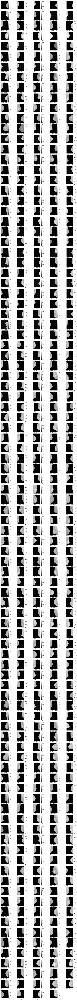

In [44]:
plt.figure(figsize=(20,400))

view_low_list= []
dcm_low_list = []
dcm_low_scale_list = []

it_dcm = iter(dcmlowList)

for i,k in enumerate(it_dcm):
    plt.subplot(150,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    
    dcm_low = sitk.ReadImage(k)
    dcm_low_list.append(dcm_low)

#     dcm_low_scale = sitk.IntensityWindowing(dcm, windowMinimum= 1820, windowMaximum= 2350, outputMinimum= 1820, outputMaximum= 2350)
#     dcm_low_scale_list.append(dcm_scale)  

    ary_low = sitk.GetArrayFromImage(dcm_low)[0,:,:]
    ary_low = cv.resize(ary_low, None, fx=0.2, fy=0.2)
    
    img_low = sitk.GetImageFromArray(ary_low)
    
    view_low = sitk.GetArrayViewFromImage(img_low)

#     view_scale = view/256
    view_low_list.append(ary_low)
    
    plt.imshow(view_low, cmap= 'gray')
    plt.xlabel(k[-15:])
    plt.colorbar()

In [45]:
from __future__ import print_function
import six
import os

import radiomics
from radiomics import featureextractor


In [46]:
def get_radiomics_features(features, feature_names):
    samples = np.zeros((len(dcm_list2), len(feature_names)))
    for i in range(len(dcm_list2)):
        a = np.array([])
        for feature_name in feature_names:
            a = np.append(a, features[i][feature_name])
        samples[i-1,:] = a
    samples = np.nan_to_num(samples)
    table = pd.DataFrame(data= samples, columns= feature_names)
    return table, samples


In [47]:
extractor = featureextractor.RadiomicsFeatureExtractor()
extractor.enableAllImageTypes()
extractor.enableAllFeatures


print('Extraction parameters:\n\t', extractor.settings)
print('Enabled filters:\n\t', extractor.enabledImagetypes)
print('Enabled features:\n\t', extractor.enabledFeatures)

Extraction parameters:
	 {'minimumROIDimensions': 2, 'minimumROISize': None, 'normalize': False, 'normalizeScale': 1, 'removeOutliers': None, 'resampledPixelSpacing': None, 'interpolator': 'sitkBSpline', 'preCrop': False, 'padDistance': 5, 'distances': [1], 'force2D': False, 'force2Ddimension': 0, 'resegmentRange': None, 'label': 1, 'additionalInfo': True}
Enabled filters:
	 {'Original': {}, 'Exponential': {}, 'Gradient': {}, 'LBP2D': {}, 'LBP3D': {}, 'LoG': {}, 'Logarithm': {}, 'Square': {}, 'SquareRoot': {}, 'Wavelet': {}}
Enabled features:
	 {'firstorder': [], 'glcm': [], 'gldm': [], 'glrlm': [], 'glszm': [], 'ngtdm': [], 'shape': []}


In [48]:
%%time


features_low = {}
       
for i in range(len(dcm_low_list)):

    features_low[i] = extractor.execute( dcm_low_list[i], nii_list[i])


GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
Calculating Local Binary Pattern in 2D, but extracting features in 3D. Use with caution!
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
Could not load required package "scipy" or "trimesh", cannot implement filter LBP 3D
Image too small to apply LoG filter, size: [2394 3062    1]
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmet

Wall time: 6h 22min 2s


In [49]:
feature_low_name_original = list(sorted(filter (lambda k: k.startswith('original_'), features_low[1])))
feature_low_name_wavelet = list(sorted(filter (lambda k: k.startswith('wavelet-'), features_low[1])))
feature_low_name_squareroot = list(sorted(filter (lambda k: k.startswith('squareroot_'), features_low[1])))
feature_low_name_exponential = list(sorted(filter (lambda k: k.startswith('exponential_'), features_low[1])))
feature_low_name_square = list(sorted(filter (lambda k: k.startswith('square_'), features_low[1])))
feature_low_name_logarithm = list(sorted(filter (lambda k: k.startswith('logarithm_'), features_low[1])))
feature_low_name_lbp_2d = list(sorted(filter (lambda k: k.startswith('lbp-2D_'), features_low[1])))
feature_low_name_gradient = list(sorted(filter (lambda k: k.startswith('gradient_'), features_low[1])))

In [51]:
radiomics_low_original, samples_low_original = get_radiomics_features(features_low, feature_low_name_original)
radiomics_low_wavelet, samples_low_wavelet = get_radiomics_features(features_low, feature_low_name_wavelet)
radiomics_low_squareroot, samples_low_squareroot = get_radiomics_features(features_low, feature_low_name_squareroot)
radiomics_low_exponential, samples_low_exponential = get_radiomics_features(features_low, feature_low_name_exponential)
radiomics_low_square, samples_low_square = get_radiomics_features(features_low, feature_low_name_square)
radiomics_low_logarithm, samples_low_logarithm = get_radiomics_features(features_low, feature_low_name_logarithm)
radiomics_low_lbp_2d, samples_low_lbp_2d = get_radiomics_features(features_low, feature_low_name_lbp_2d)
radiomics_low_gradient, samples_low_gradient = get_radiomics_features(features_low, feature_low_name_gradient)

In [52]:
radiomics_low_original = pd.concat([data_final, radiomics_low_original], axis=1, sort=False)
radiomics_low_original.to_csv('radiomics_low_original_1030.csv')
radiomics_low_original.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,original_shape_Maximum2DDiameterColumn,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_MinorAxisLength,original_shape_Sphericity,original_shape_SurfaceArea,original_shape_SurfaceVolumeRatio,original_shape_VoxelVolume
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,14.2,16.3,17.057843,17.057843,176.934167,13.832960,0.370623,411.237398,2.324240,178.23
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,14.7,19.5,21.002143,21.002143,237.336667,15.653765,0.345546,536.481386,2.260424,238.86
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,29.5,32.4,43.790524,43.790524,802.034167,26.075258,0.241627,1727.692703,2.154139,804.79
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,31.2,37.1,44.984108,44.984108,886.439167,26.993007,0.235669,1893.568038,2.136151,889.25
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,39.4,61.6,68.562380,68.562380,2070.756667,40.415129,0.181774,4322.195046,2.087254,2074.91


In [53]:
radiomics_low_wavelet = pd.concat([data_final, radiomics_low_wavelet], axis=1, sort=False)
radiomics_low_wavelet.to_csv('radiomics_low_wavelet_1030.csv')
radiomics_low_wavelet.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,wavelet-LLL_glszm_SmallAreaHighGrayLevelEmphasis,wavelet-LLL_glszm_SmallAreaLowGrayLevelEmphasis,wavelet-LLL_glszm_ZoneEntropy,wavelet-LLL_glszm_ZonePercentage,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_ngtdm_Busyness,wavelet-LLL_ngtdm_Coarseness,wavelet-LLL_ngtdm_Complexity,wavelet-LLL_ngtdm_Contrast,wavelet-LLL_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,2133.213735,0.000484,7.833307,0.524827,2.658891,0.067164,0.002697,4429.508787,0.070690,9.628382
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,1490.861233,0.000638,7.613558,0.525454,2.728722,0.150006,0.001738,3440.946040,0.064963,4.480373
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,2932.586948,0.000239,7.546836,0.551883,2.347199,0.279730,0.000423,6856.689234,0.043956,2.340972
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,4512.522647,0.000157,7.594557,0.541805,2.547772,0.206454,0.000388,9100.346193,0.041601,3.520559
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,5309.335463,0.000137,7.607898,0.614316,1.407159,0.434346,0.000171,13170.868731,0.060401,1.518866


In [54]:
radiomics_low_squareroot = pd.concat([data_final, radiomics_low_squareroot], axis=1, sort=False)
radiomics_low_squareroot.to_csv('radiomics_low_squareroot_1030.csv')
radiomics_low_squareroot.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,squareroot_glszm_SmallAreaHighGrayLevelEmphasis,squareroot_glszm_SmallAreaLowGrayLevelEmphasis,squareroot_glszm_ZoneEntropy,squareroot_glszm_ZonePercentage,squareroot_glszm_ZoneVariance,squareroot_ngtdm_Busyness,squareroot_ngtdm_Coarseness,squareroot_ngtdm_Complexity,squareroot_ngtdm_Contrast,squareroot_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,96.011810,0.005482,6.450887,0.137126,698.493382,3.105522,0.001070,111.319447,0.028360,0.197501
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,74.081407,0.007017,6.409814,0.146153,590.579213,6.132440,0.000705,95.344555,0.027462,0.101355
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,130.736803,0.002976,6.492237,0.173760,605.763597,11.682592,0.000183,177.815797,0.018356,0.055734
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,198.731171,0.001839,6.538733,0.174012,492.946521,8.673554,0.000167,248.389685,0.018126,0.083765
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,186.206382,0.001979,6.639177,0.208481,200.355662,20.607976,0.000076,265.422455,0.023311,0.031363


In [55]:
radiomics_low_exponential = pd.concat([data_final, radiomics_low_exponential], axis=1, sort=False)
radiomics_low_exponential.to_csv('radiomics_low_exponential_1030.csv')
radiomics_low_exponential.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,1282.295201,0.001493,7.168221,0.688156,1.233212,0.268254,0.001135,13174.499553,0.152438,5.469542
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,357.927174,0.002817,6.739099,0.518379,4.774006,1.494290,0.000744,1794.663044,0.084489,0.805936
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,336.126223,0.002169,6.657761,0.479666,5.990247,4.222077,0.000191,1958.389441,0.046656,0.296034
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,201.912977,0.002735,6.543396,0.360045,32.440140,8.070915,0.000173,712.393385,0.038269,0.123153
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,2649.314099,0.000527,7.220896,0.770564,0.546388,1.801143,0.000079,32332.486732,0.193525,0.572735


In [56]:
radiomics_low_square = pd.concat([data_final, radiomics_low_square], axis=1, sort=False)
radiomics_low_square.to_csv('radiomics_low_square_1030.csv')
radiomics_low_square.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,square_glszm_SmallAreaHighGrayLevelEmphasis,square_glszm_SmallAreaLowGrayLevelEmphasis,square_glszm_ZoneEntropy,square_glszm_ZonePercentage,square_glszm_ZoneVariance,square_ngtdm_Busyness,square_ngtdm_Coarseness,square_ngtdm_Complexity,square_ngtdm_Contrast,square_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,812.672498,0.001352,6.993533,0.567581,2.157110,0.439969,0.001140,2567.548085,0.098936,1.549444
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,507.073782,0.001695,6.791727,0.533827,2.798933,1.049702,0.000753,1600.886335,0.083044,0.666379
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,835.320127,0.000805,6.713069,0.549423,2.761694,2.088518,0.000193,2720.496005,0.053867,0.320509
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,1013.249371,0.000609,6.728711,0.522980,3.462001,1.919381,0.000177,2785.671675,0.051010,0.351941
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,1901.976421,0.000405,6.822082,0.654515,1.151821,2.650136,0.000080,6881.250643,0.085983,0.237531


In [57]:
radiomics_low_logarithm = pd.concat([data_final, radiomics_low_logarithm], axis=1, sort=False)
radiomics_low_logarithm.to_csv('radiomics_low_logarithm_1030.csv')
radiomics_low_logarithm.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,logarithm_glszm_SmallAreaHighGrayLevelEmphasis,logarithm_glszm_SmallAreaLowGrayLevelEmphasis,logarithm_glszm_ZoneEntropy,logarithm_glszm_ZonePercentage,logarithm_glszm_ZoneVariance,logarithm_ngtdm_Busyness,logarithm_ngtdm_Coarseness,logarithm_ngtdm_Complexity,logarithm_ngtdm_Contrast,logarithm_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,13.273009,0.043435,4.304082,0.028559,1.566305e+05,27.662896,0.000938,4.344387,0.008178,0.019675
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,8.230826,0.082514,4.321236,0.030018,1.718707e+05,71.924654,0.000583,3.450988,0.010156,0.007927
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,16.905123,0.025486,4.576165,0.032170,6.980936e+05,113.001962,0.000157,7.243028,0.005795,0.005175
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,25.688643,0.015053,4.652077,0.032803,5.062148e+05,88.595452,0.000135,10.978987,0.006231,0.007906
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,18.421851,0.022534,4.660439,0.036296,1.263683e+06,272.298265,0.000063,8.107263,0.007932,0.002114


In [58]:
radiomics_low_lbp_2d = pd.concat([data_final, radiomics_low_lbp_2d], axis=1, sort=False)
radiomics_low_lbp_2d.to_csv('radiomics_low_lbp_2d_1030.csv')
radiomics_low_lbp_2d.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,lbp-2D_glszm_SmallAreaHighGrayLevelEmphasis,lbp-2D_glszm_SmallAreaLowGrayLevelEmphasis,lbp-2D_glszm_ZoneEntropy,lbp-2D_glszm_ZonePercentage,lbp-2D_glszm_ZoneVariance,lbp-2D_ngtdm_Busyness,lbp-2D_ngtdm_Coarseness,lbp-2D_ngtdm_Complexity,lbp-2D_ngtdm_Contrast,lbp-2D_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,3.148027e-09,3.148027e-09,-3.203427e-16,0.000056,0.0,0.0,1000000.0,0.0,0.0,0.0
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,1.752722e-09,1.752722e-09,-3.203427e-16,0.000042,0.0,0.0,1000000.0,0.0,0.0,0.0
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,1.543956e-10,1.543956e-10,-3.203427e-16,0.000012,0.0,0.0,1000000.0,0.0,0.0,0.0
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,1.264597e-10,1.264597e-10,-3.203427e-16,0.000011,0.0,0.0,1000000.0,0.0,0.0,0.0
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,2.322745e-11,2.322745e-11,-3.203427e-16,0.000005,0.0,0.0,1000000.0,0.0,0.0,0.0


In [59]:
radiomics_low_gradient = pd.concat([data_final, radiomics_low_gradient], axis=1, sort=False)
radiomics_low_gradient.to_csv('radiomics_low_gradient_1030.csv')
radiomics_low_gradient.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,gradient_glszm_SmallAreaHighGrayLevelEmphasis,gradient_glszm_SmallAreaLowGrayLevelEmphasis,gradient_glszm_ZoneEntropy,gradient_glszm_ZonePercentage,gradient_glszm_ZoneVariance,gradient_ngtdm_Busyness,gradient_ngtdm_Coarseness,gradient_ngtdm_Complexity,gradient_ngtdm_Contrast,gradient_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,212.609748,0.020102,5.570866,0.823262,0.299309,3.885650,0.000313,8569.230752,0.174028,0.659653
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,214.762221,0.020468,5.596899,0.821192,0.310733,4.902099,0.000233,9401.219026,0.166940,0.534773
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,261.405609,0.018345,5.709894,0.833261,0.289827,15.097608,0.000070,10269.538025,0.205241,0.146469
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,251.422980,0.018735,5.699065,0.828923,0.303821,17.207682,0.000064,9716.211333,0.199572,0.130209
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,364.619238,0.013331,5.815185,0.862635,0.207574,27.423971,0.000027,17083.019693,0.234696,0.075798


In [60]:
%%time

features = {}

for i in range(len(dcm_list2)):

    features[i] = extractor.execute(dcm_list2[i], nii_list[i])

    

GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
Calculating Local Binary Pattern in 2D, but extracting features in 3D. Use with caution!
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
Could not load required package "scipy" or "trimesh", cannot implement filter LBP 3D
Image too small to apply LoG filter, size: [2394 3062    1]
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
GLCM is symmet

Wall time: 6h 19min 1s


In [61]:
feature_re_name_original = list(sorted(filter (lambda k: k.startswith('original_'), features[1])))
feature_re_name_wavelet = list(sorted(filter (lambda k: k.startswith('wavelet-'), features[1])))
feature_re_name_squareroot = list(sorted(filter (lambda k: k.startswith('squareroot_'), features[1])))
feature_re_name_exponential = list(sorted(filter (lambda k: k.startswith('exponential_'), features[1])))
feature_re_name_square = list(sorted(filter (lambda k: k.startswith('square_'), features[1])))
feature_re_name_logarithm = list(sorted(filter (lambda k: k.startswith('logarithm_'), features[1])))
feature_re_name_lbp_2d = list(sorted(filter (lambda k: k.startswith('lbp-2D_'), features[1])))
feature_re_name_gradient = list(sorted(filter (lambda k: k.startswith('gradient_'), features[1])))

radiomics_re_original, samples_re_original = get_radiomics_features(features, feature_re_name_original)
radiomics_re_wavelet, samples_re_wavelet = get_radiomics_features(features, feature_re_name_wavelet)
radiomics_re_squareroot, samples_re_squareroot = get_radiomics_features(features, feature_re_name_squareroot)
radiomics_re_exponential, samples_re_exponential = get_radiomics_features(features, feature_re_name_exponential)
radiomics_re_square, samples_re_square = get_radiomics_features(features, feature_re_name_square)
radiomics_re_logarithm, samples_re_logarithm = get_radiomics_features(features, feature_re_name_logarithm)
radiomics_re_lbp_2d, samples_re_lbp_2d = get_radiomics_features(features, feature_re_name_lbp_2d)
radiomics_re_gradient, samples_re_gradient = get_radiomics_features(features, feature_re_name_gradient)

In [62]:
radiomics_re_original = pd.concat([data_final, radiomics_re_original], axis=1, sort=False)
radiomics_re_original.to_csv('radiomics_re_original_1030.csv')
radiomics_re_original.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,original_shape_Maximum2DDiameterColumn,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_MinorAxisLength,original_shape_Sphericity,original_shape_SurfaceArea,original_shape_SurfaceVolumeRatio,original_shape_VoxelVolume
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,14.2,16.3,17.057843,17.057843,176.934167,13.832960,0.370623,411.237398,2.324240,178.23
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,14.7,19.5,21.002143,21.002143,237.336667,15.653765,0.345546,536.481386,2.260424,238.86
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,29.5,32.4,43.790524,43.790524,802.034167,26.075258,0.241627,1727.692703,2.154139,804.79
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,31.2,37.1,44.984108,44.984108,886.439167,26.993007,0.235669,1893.568038,2.136151,889.25
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,39.4,61.6,68.562380,68.562380,2070.756667,40.415129,0.181774,4322.195046,2.087254,2074.91


In [63]:
radiomics_re_wavelet = pd.concat([data_final, radiomics_re_wavelet], axis=1, sort=False)
radiomics_re_wavelet.to_csv('radiomics_re_wavelet_1030.csv')
radiomics_re_wavelet.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,wavelet-LLL_glszm_SmallAreaHighGrayLevelEmphasis,wavelet-LLL_glszm_SmallAreaLowGrayLevelEmphasis,wavelet-LLL_glszm_ZoneEntropy,wavelet-LLL_glszm_ZonePercentage,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_ngtdm_Busyness,wavelet-LLL_ngtdm_Coarseness,wavelet-LLL_ngtdm_Complexity,wavelet-LLL_ngtdm_Contrast,wavelet-LLL_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,45.611830,0.005278,7.137515,0.150087,167.632841,3.933609,0.001157,78.775269,0.023513,0.161960
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,31.747760,0.008659,6.936392,0.146613,224.031234,8.137630,0.000746,63.691013,0.021870,0.082922
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,57.991128,0.003674,7.483600,0.143093,189.010721,8.922986,0.000292,150.146489,0.015609,0.089712
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,65.525776,0.003164,7.596488,0.130942,262.160814,8.807367,0.000275,141.711440,0.016734,0.082572
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,235.037866,0.001077,7.907126,0.197401,69.513234,5.922683,0.000178,364.560272,0.027130,0.105495


In [64]:
radiomics_re_squareroot = pd.concat([data_final, radiomics_re_squareroot], axis=1, sort=False)
radiomics_re_squareroot.to_csv('radiomics_re_squareroot_1030.csv')
radiomics_re_squareroot.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,squareroot_glszm_SmallAreaHighGrayLevelEmphasis,squareroot_glszm_SmallAreaLowGrayLevelEmphasis,squareroot_glszm_ZoneEntropy,squareroot_glszm_ZonePercentage,squareroot_glszm_ZoneVariance,squareroot_ngtdm_Busyness,squareroot_ngtdm_Coarseness,squareroot_ngtdm_Complexity,squareroot_ngtdm_Contrast,squareroot_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,6.761429,0.080632,4.342907,0.040790,171354.079186,93.078793,0.000569,2.684978,0.009703,0.005404
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,6.607301,0.080037,4.343347,0.046094,179677.605323,157.653719,0.000340,3.372329,0.012558,0.003292
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,10.442351,0.049471,4.770010,0.042073,456730.609276,225.608618,0.000127,6.559726,0.009489,0.002677
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,10.567956,0.055136,4.826448,0.045679,367330.434159,203.531936,0.000118,9.308669,0.009815,0.003496
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,19.335735,0.027051,5.103644,0.045718,691917.080428,254.566176,0.000067,11.478608,0.012751,0.002270


In [65]:
radiomics_re_square = pd.concat([data_final, radiomics_re_square], axis=1, sort=False)
radiomics_re_square.to_csv('radiomics_re_square_1030.csv')
radiomics_re_square.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,square_glszm_SmallAreaHighGrayLevelEmphasis,square_glszm_SmallAreaLowGrayLevelEmphasis,square_glszm_ZoneEntropy,square_glszm_ZonePercentage,square_glszm_ZoneVariance,square_ngtdm_Busyness,square_ngtdm_Coarseness,square_ngtdm_Complexity,square_ngtdm_Contrast,square_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,40.304050,0.011204,6.038685,0.185771,256.596919,12.513988,0.000597,58.548714,0.026612,0.048019
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,18.111476,0.035046,5.388355,0.126099,3745.772695,43.764704,0.000377,24.408952,0.021271,0.014927
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,25.868655,0.019009,5.658331,0.087116,13779.704699,66.397708,0.000140,36.936737,0.013398,0.011036
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,17.039256,0.035845,5.254452,0.065775,99326.946810,129.127495,0.000126,18.010535,0.014642,0.005482
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,111.582532,0.003747,6.770678,0.202303,175.279613,31.957431,0.000083,182.302898,0.029278,0.019484


In [66]:
radiomics_re_exponential = pd.concat([data_final, radiomics_re_exponential], axis=1, sort=False)
radiomics_re_exponential.to_csv('radiomics_re_exponential_1030.csv')
radiomics_re_exponential.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,97.686633,0.006102,6.102526,0.405880,8.380289e+00,5.134254,0.000617,283.352533,0.045980,0.139845
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,4.801431,0.188815,4.537643,0.055053,1.247681e+05,194.384055,0.000361,3.388447,0.014867,0.003478
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,3.202843,0.269086,4.052092,0.020713,2.405499e+06,517.629536,0.000188,0.976776,0.004931,0.001095
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,5.040802,0.133220,2.716255,0.000731,1.185870e+08,26.133155,0.004807,0.018418,0.000008,0.009673
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,100.543790,0.004511,6.689270,0.227297,1.898790e+02,36.520434,0.000083,207.423080,0.032117,0.020582


In [67]:
radiomics_re_logarithm = pd.concat([data_final, radiomics_re_logarithm], axis=1, sort=False)
radiomics_re_logarithm.to_csv('radiomics_re_logarithm_1030.csv')
radiomics_re_logarithm.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,logarithm_glszm_SmallAreaHighGrayLevelEmphasis,logarithm_glszm_SmallAreaLowGrayLevelEmphasis,logarithm_glszm_ZoneEntropy,logarithm_glszm_ZonePercentage,logarithm_glszm_ZoneVariance,logarithm_ngtdm_Busyness,logarithm_ngtdm_Coarseness,logarithm_ngtdm_Complexity,logarithm_ngtdm_Contrast,logarithm_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,2.125546,0.197707,2.962897,0.010212,1.384033e+06,612.095350,0.001183,0.094849,0.008777,0.001183
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,0.661277,0.660258,2.114588,0.009629,2.323609e+06,127.057559,0.002060,0.040655,0.001177,0.002054
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,1.369641,0.370028,3.675164,0.019496,1.217892e+06,1450.950617,0.000147,0.674016,0.013659,0.000479
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,3.742950,0.113628,3.647364,0.019455,1.641978e+06,600.856786,0.000136,1.162689,0.006795,0.000811
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,3.712394,0.110787,3.687521,0.012121,8.015095e+06,710.113795,0.000105,0.644517,0.003394,0.000627


In [68]:
radiomics_re_lbp_2d = pd.concat([data_final, radiomics_re_lbp_2d], axis=1, sort=False)
radiomics_re_lbp_2d.to_csv('radiomics_re_lbp_2d_1030.csv')  
radiomics_re_lbp_2d.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,lbp-2D_glszm_SmallAreaHighGrayLevelEmphasis,lbp-2D_glszm_SmallAreaLowGrayLevelEmphasis,lbp-2D_glszm_ZoneEntropy,lbp-2D_glszm_ZonePercentage,lbp-2D_glszm_ZoneVariance,lbp-2D_ngtdm_Busyness,lbp-2D_ngtdm_Coarseness,lbp-2D_ngtdm_Complexity,lbp-2D_ngtdm_Contrast,lbp-2D_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,3.148027e-09,3.148027e-09,-3.203427e-16,0.000056,0.0,0.0,1000000.0,0.0,0.0,0.0
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,1.752722e-09,1.752722e-09,-3.203427e-16,0.000042,0.0,0.0,1000000.0,0.0,0.0,0.0
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,1.543956e-10,1.543956e-10,-3.203427e-16,0.000012,0.0,0.0,1000000.0,0.0,0.0,0.0
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,1.264597e-10,1.264597e-10,-3.203427e-16,0.000011,0.0,0.0,1000000.0,0.0,0.0,0.0
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,2.322745e-11,2.322745e-11,-3.203427e-16,0.000005,0.0,0.0,1000000.0,0.0,0.0,0.0


In [69]:
radiomics_re_gradient = pd.concat([data_final, radiomics_re_gradient], axis=1, sort=False)
radiomics_re_gradient.to_csv('radiomics_re_gradient_1030.csv')
radiomics_re_gradient.head()

,patientID,SeriesTime,ViewPosition,ImageLaterality,CompressionForce,breast_background,lesion_val,image_background,value difference,bpe,...,gradient_glszm_SmallAreaHighGrayLevelEmphasis,gradient_glszm_SmallAreaLowGrayLevelEmphasis,gradient_glszm_ZoneEntropy,gradient_glszm_ZonePercentage,gradient_glszm_ZoneVariance,gradient_ngtdm_Busyness,gradient_ngtdm_Coarseness,gradient_ngtdm_Complexity,gradient_ngtdm_Contrast,gradient_ngtdm_Strength
0,X18108565,145635.0,SIO,L,160.0,80.815942,129.884768,0.000000,49.068826,121.289613,...,29.164107,0.081374,5.063222,0.566627,2.272152,31.486809,0.000309,325.346044,0.076867,0.054769
1,X18108565,145804.0,ML,L,140.0,78.807362,104.430120,0.000004,25.622758,107.131583,...,29.409151,0.081415,5.071750,0.565436,2.454944,46.797405,0.000230,277.751425,0.087145,0.033030
2,X18108565,150155.0,MLO,L,130.0,84.209989,120.339687,0.000000,36.129699,111.624878,...,27.989824,0.084145,5.092890,0.552616,2.754605,107.759497,0.000070,472.964184,0.051724,0.022113
3,X18113130,110552.0,CC,R,100.0,81.955445,123.711947,0.000004,41.756503,127.023335,...,26.523505,0.090110,5.087068,0.544290,3.025249,156.623123,0.000063,321.780589,0.066674,0.012735
4,X18113130,111130.0,CC,R,80.0,88.603665,107.358721,0.000000,18.755056,140.304344,...,39.819155,0.068135,5.102525,0.621878,1.562181,245.442015,0.000027,579.238106,0.081648,0.007525
